In [1]:
import numpy as np
from random import random

class dataGenerator(object):

    def __init__(self, folder, flip=True):
        self.flip = flip
        self.images = np.load(folder)[:, :, :, :]
        self.images = self.images.astype(np.float32)
            
    def get_batch(self, num):

        idx = np.random.randint(0, self.images.shape[0] - 1, num)
        out = []

        for i in idx:
            img = self.images[i]
            if self.flip and random() < 0.5:
                img = np.flip(img, 1)
            out.append(img)

        return np.array(out)




In [2]:
# -*- coding: utf-8 -*-
"""Convolutional layers.
"""
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

from tensorflow.keras import backend as K
from tensorflow.keras import initializers, regularizers, constraints
from tensorflow.keras.layers import Layer, InputSpec
from tensorflow.python.keras.utils import conv_utils
import tensorflow as tf

class Conv2DMod(Layer):

    def __init__(self,
                 filters,
                 kernel_size,
                 strides=1,
                 padding='valid',
                 dilation_rate=1,
                 kernel_initializer='glorot_uniform',
                 kernel_regularizer=None,
                 activity_regularizer=None,
                 kernel_constraint=None,
                 demod=True,
                 **kwargs):
        super(Conv2DMod, self).__init__(**kwargs)
        self.filters = filters
        self.rank = 2
        self.kernel_size = conv_utils.normalize_tuple(kernel_size, 2, 'kernel_size')
        self.strides = conv_utils.normalize_tuple(strides, 2, 'strides')
        self.padding = conv_utils.normalize_padding(padding)
        self.dilation_rate = conv_utils.normalize_tuple(dilation_rate, 2, 'dilation_rate')
        self.kernel_initializer = initializers.get(kernel_initializer)
        self.kernel_regularizer = regularizers.get(kernel_regularizer)
        self.activity_regularizer = regularizers.get(activity_regularizer)
        self.kernel_constraint = constraints.get(kernel_constraint)
        self.demod = demod
        self.input_spec = [InputSpec(ndim = 4),
                            InputSpec(ndim = 2)]

    def build(self, input_shape):
        channel_axis = -1
        if input_shape[0][channel_axis] is None:
            raise ValueError('The channel dimension of the inputs '
                             'should be defined. Found `None`.')
        input_dim = input_shape[0][channel_axis]
        kernel_shape = self.kernel_size + (input_dim, self.filters)

        if input_shape[1][-1] != input_dim:
            raise ValueError('The last dimension of modulation input should be equal to input dimension.')

        self.kernel = self.add_weight(shape=kernel_shape,
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)

        # Set input spec.
        self.input_spec = [InputSpec(ndim=4, axes={channel_axis: input_dim}),
                            InputSpec(ndim=2)]
        self.built = True

    def call(self, inputs):

        #To channels last
        x = tf.transpose(inputs[0], [0, 3, 1, 2])

        #Get weight and bias modulations
        #Make sure w's shape is compatible with self.kernel
        w = K.expand_dims(K.expand_dims(K.expand_dims(inputs[1], axis = 1), axis = 1), axis = -1)

        #Add minibatch layer to weights
        wo = K.expand_dims(self.kernel, axis = 0)

        #Modulate
        weights = wo * (w+1)

        #Demodulate
        if self.demod:
            d = K.sqrt(K.sum(K.square(weights), axis=[1,2,3], keepdims = True) + 1e-8)
            weights = weights / d

        #Reshape/scale input
        x = tf.reshape(x, [1, -1, x.shape[2], x.shape[3]]) # Fused => reshape minibatch to convolution groups.
        w = tf.reshape(tf.transpose(weights, [1, 2, 3, 0, 4]), [weights.shape[1], weights.shape[2], weights.shape[3], -1])

        x = tf.nn.conv2d(x, w,
                strides=self.strides,
                padding="SAME",
                data_format="NCHW")

        # Reshape/scale output.
        x = tf.reshape(x, [-1, self.filters, x.shape[2], x.shape[3]]) # Fused => reshape convolution groups back to minibatch.
        x = tf.transpose(x, [0, 2, 3, 1])

        return x

    def compute_output_shape(self, input_shape):
        space = input_shape[0][1:-1]
        new_space = []
        for i in range(len(space)):
            new_dim = conv_utils.conv_output_length(
                space[i],
                self.kernel_size[i],
                padding=self.padding,
                stride=self.strides[i],
                dilation=self.dilation_rate[i])
            new_space.append(new_dim)

        return (input_shape[0],) + tuple(new_space) + (self.filters,)

    def get_config(self):
        config = {
            'filters': self.filters,
            'kernel_size': self.kernel_size,
            'strides': self.strides,
            'padding': self.padding,
            'dilation_rate': self.dilation_rate,
            'kernel_initializer': initializers.serialize(self.kernel_initializer),
            'kernel_regularizer': regularizers.serialize(self.kernel_regularizer),
            'activity_regularizer':
                regularizers.serialize(self.activity_regularizer),
            'kernel_constraint': constraints.serialize(self.kernel_constraint),
            'demod': self.demod
        }
        base_config = super(Conv2DMod, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))


2
Model: "functional_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_18 (InputLayer)           [(None, 100)]        0                                            
__________________________________________________________________________________________________
lambda_8 (Lambda)               (None, 1)            0           input_18[0][0]                   
__________________________________________________________________________________________________
dense_22 (Dense)                (None, 4608)         9216        lambda_8[0][0]                   
__________________________________________________________________________________________________
reshape_1 (Reshape)             (None, 24, 16, 12)   0           dense_22[0][0]                   
____________________________________________________________________________________

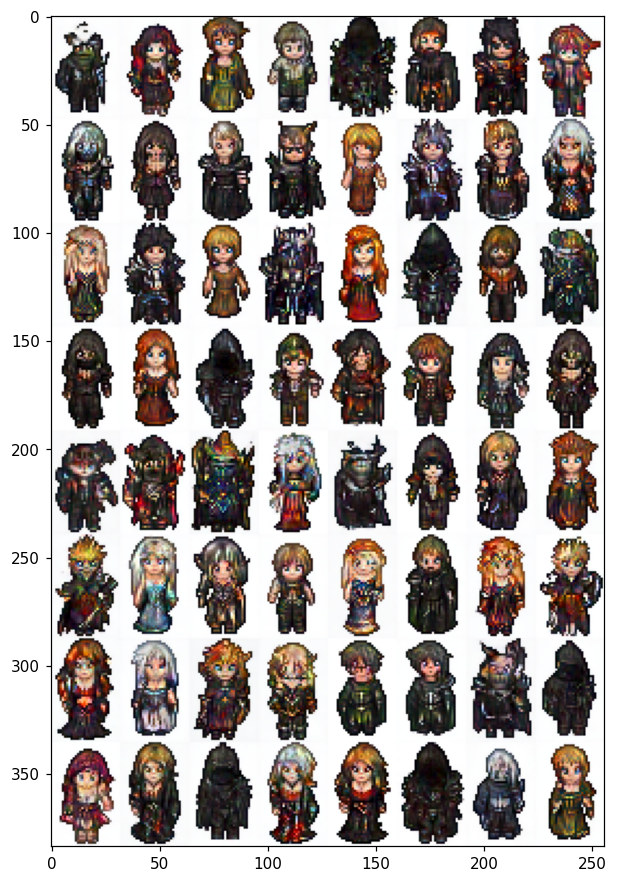



Round 200:
D: 1.5668924
G: 0.30341423
PL: 2.0848206137085254
Steps/Second: 0.78
Steps/Hour: 2821
1k Steps: 21:16
Til Completion: 70h50m



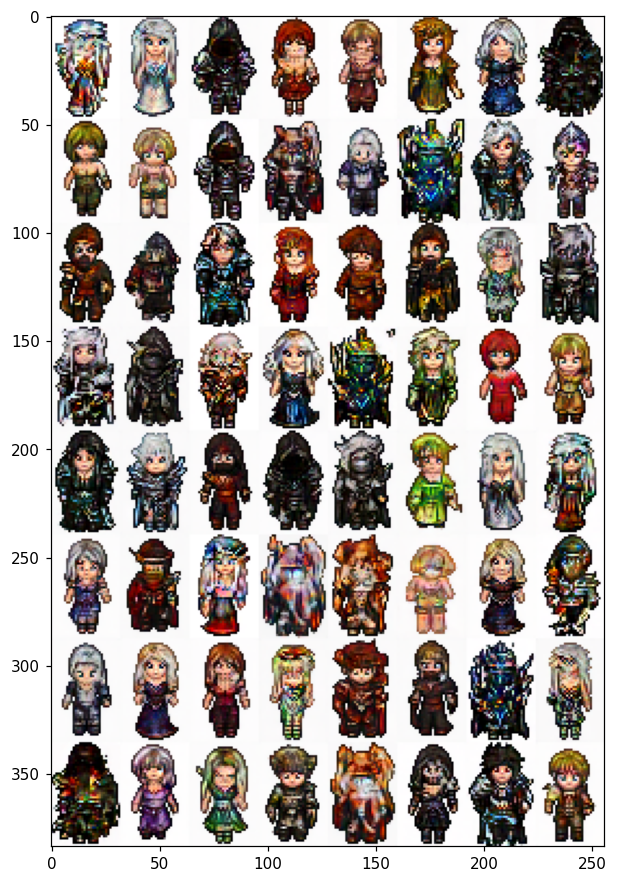



Round 300:
D: 1.5820451
G: 0.38820973
PL: 1.1310846744653038
Steps/Second: 0.79
Steps/Hour: 2837
1k Steps: 21:9
Til Completion: 70h24m



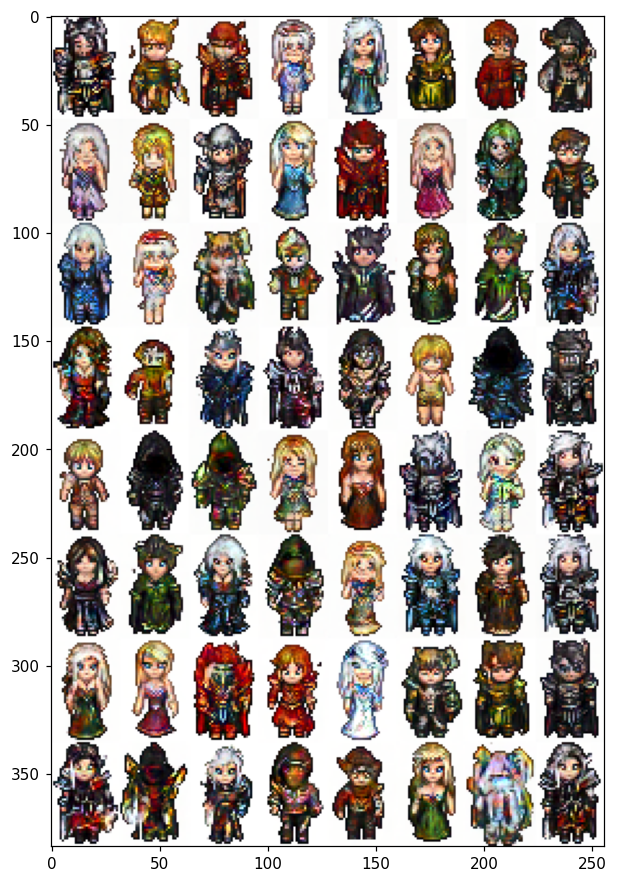



Round 400:
D: 1.7310619
G: 0.39419368
PL: 0.87195485426271
Steps/Second: 0.79
Steps/Hour: 2826
1k Steps: 21:13
Til Completion: 70h37m



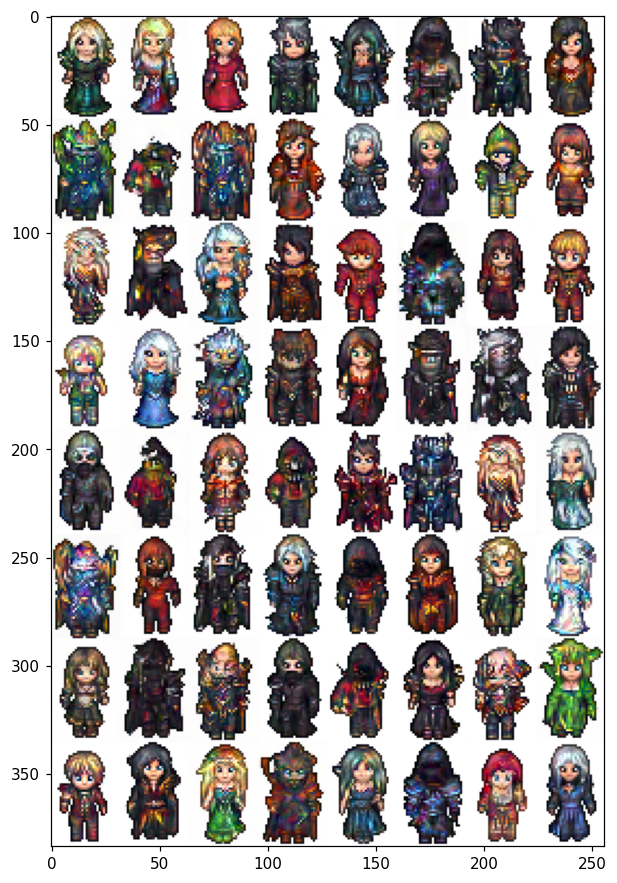



Round 500:
D: 1.5541708
G: 0.38133228
PL: 0.7633635683490994
Steps/Second: 0.79
Steps/Hour: 2826
1k Steps: 21:13
Til Completion: 70h35m



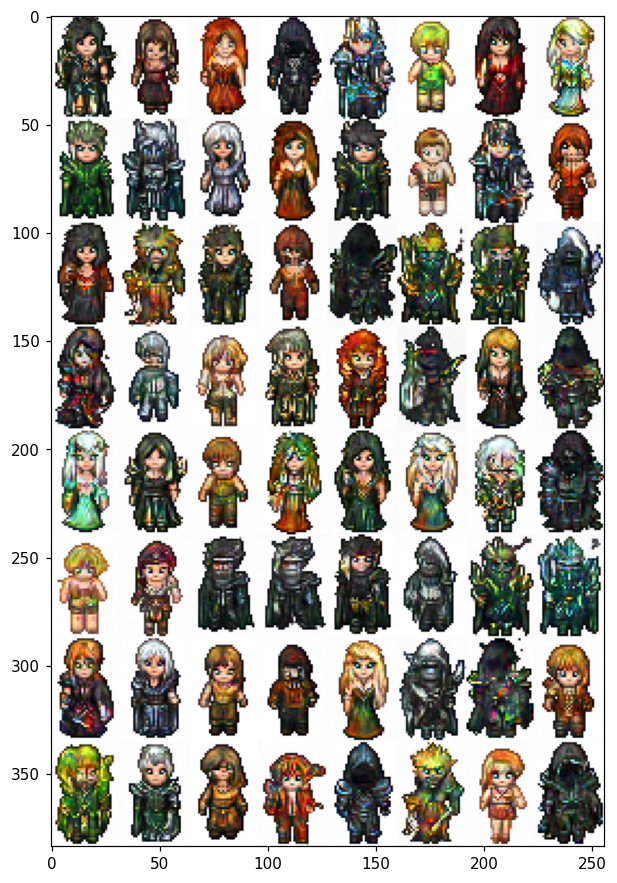



Round 600:
D: 1.6536983
G: 0.48603708
PL: 0.7186105108457561
Steps/Second: 0.79
Steps/Hour: 2838
1k Steps: 21:8
Til Completion: 70h16m



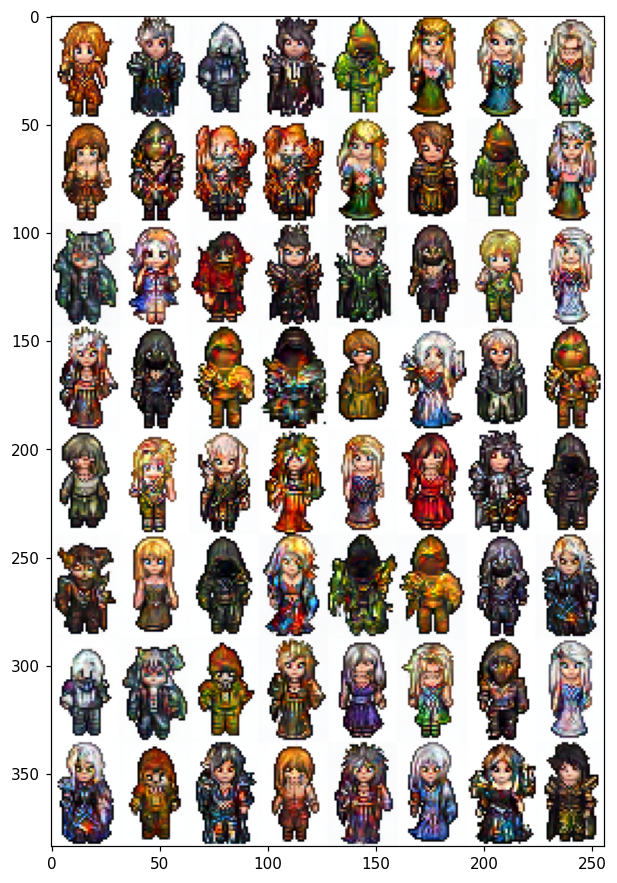



Round 700:
D: 1.6383368
G: 0.3699412
PL: 0.6296146088588931
Steps/Second: 0.79
Steps/Hour: 2833
1k Steps: 21:10
Til Completion: 70h21m



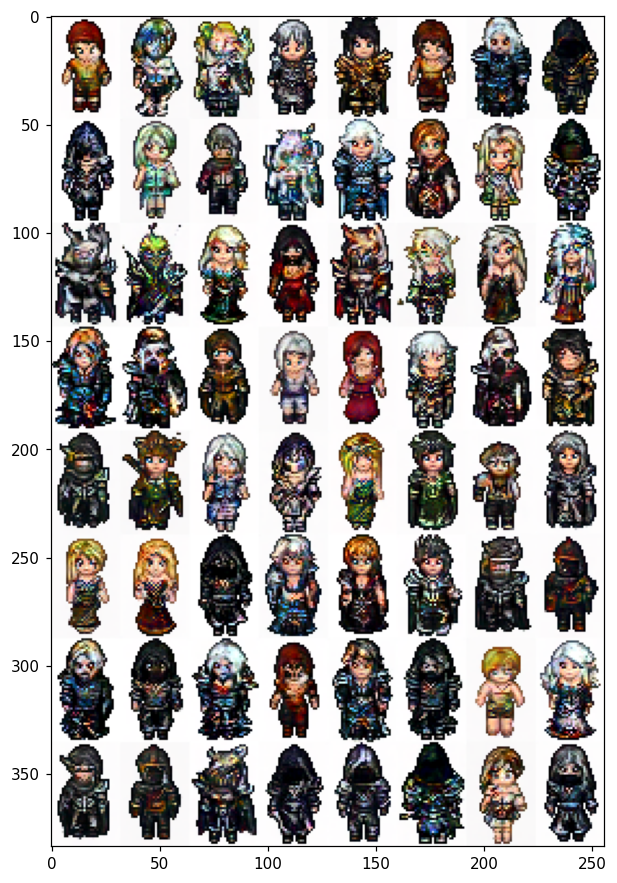



Round 800:
D: 1.616662
G: 0.35284802
PL: 0.7551044416324582
Steps/Second: 0.79
Steps/Hour: 2828
1k Steps: 21:12
Til Completion: 70h26m



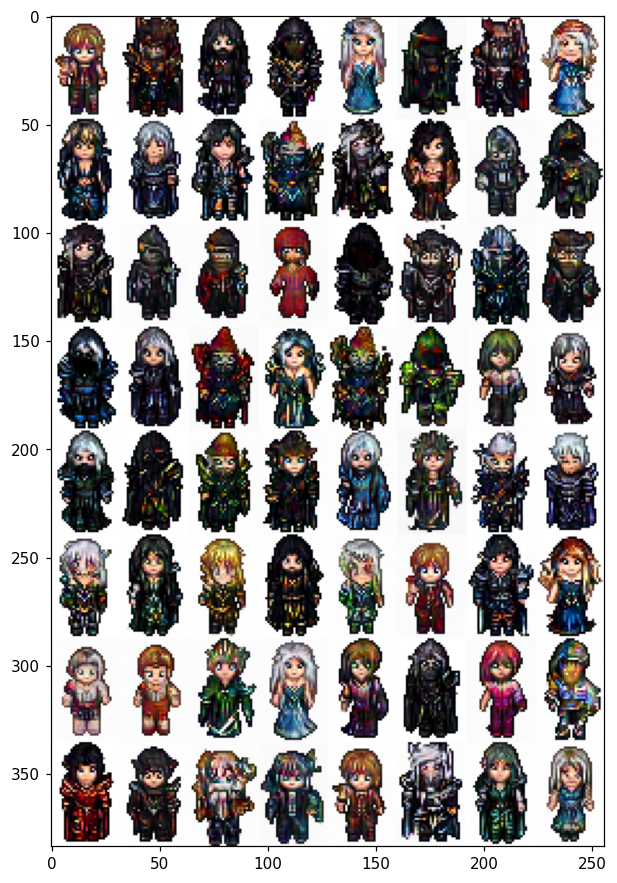



Round 900:
D: 1.6789804
G: 0.63016135
PL: 0.6824358921484047
Steps/Second: 0.79
Steps/Hour: 2828
1k Steps: 21:13
Til Completion: 70h24m



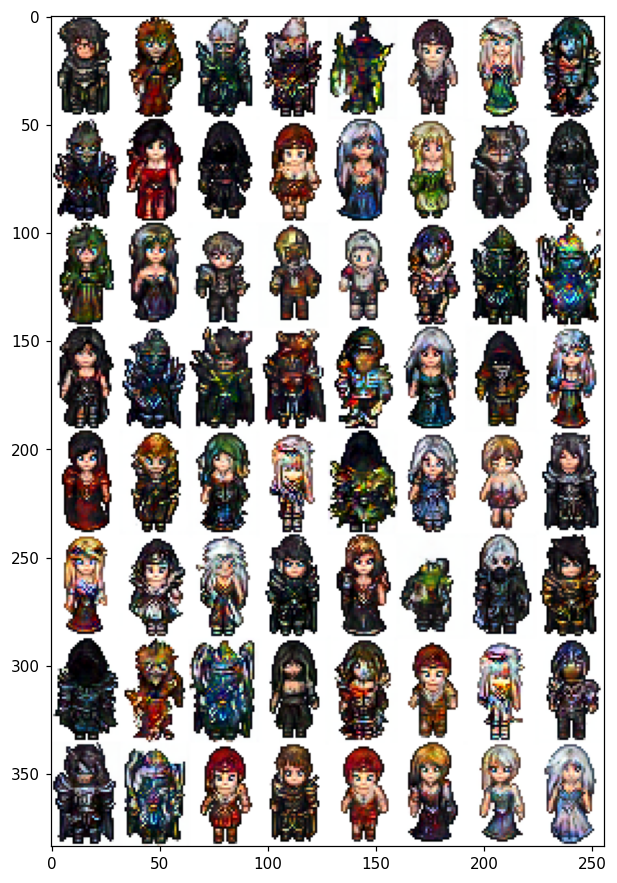



Round 1000:
D: 1.6520975
G: 0.43193072
PL: 0.6526880822257112
Steps/Second: 0.79
Steps/Hour: 2832
1k Steps: 21:11
Til Completion: 70h16m



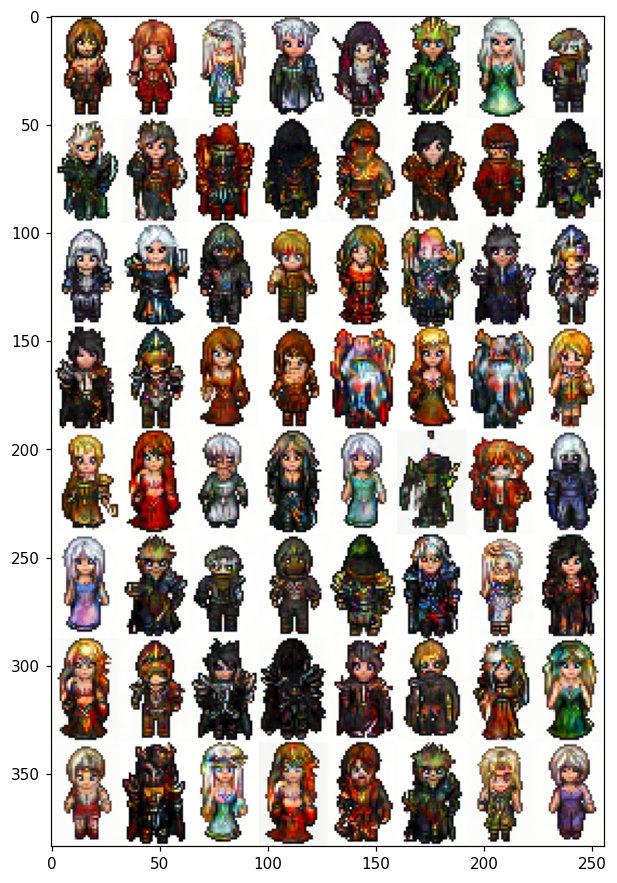



Round 1100:
D: 1.6436644
G: 0.58076566
PL: 0.6485294448029193
Steps/Second: 0.79
Steps/Hour: 2828
1k Steps: 21:13
Til Completion: 70h20m



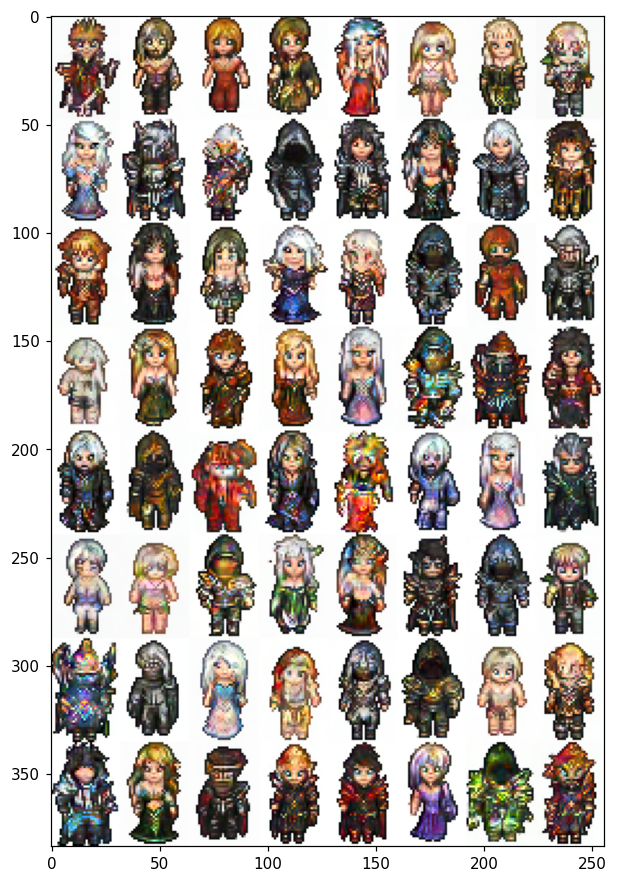



Round 1200:
D: 1.5923057
G: 0.6131493
PL: 0.7589849647007426
Steps/Second: 0.78
Steps/Hour: 2823
1k Steps: 21:15
Til Completion: 70h24m



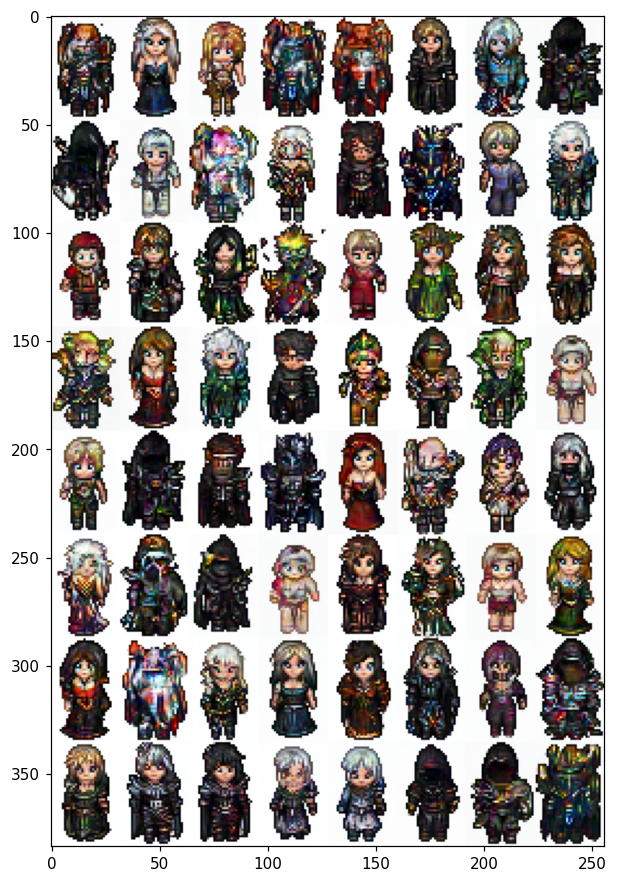



Round 1300:
D: 1.5456228
G: 0.46829313
PL: 0.7030449727753781
Steps/Second: 0.79
Steps/Hour: 2833
1k Steps: 21:10
Til Completion: 70h8m



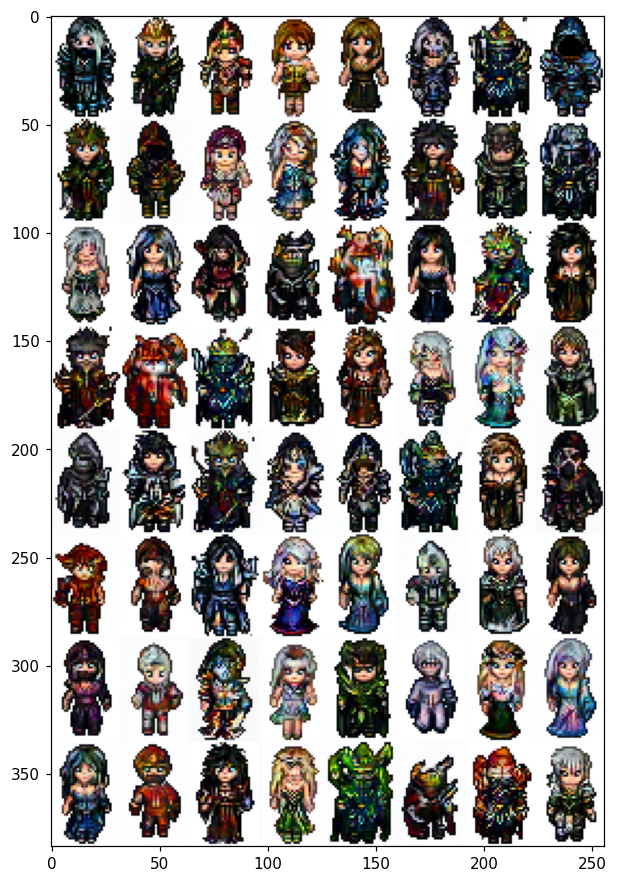



Round 1400:
D: 1.6309575
G: 0.41834098
PL: 0.6730500655710073
Steps/Second: 0.79
Steps/Hour: 2839
1k Steps: 21:8
Til Completion: 69h57m



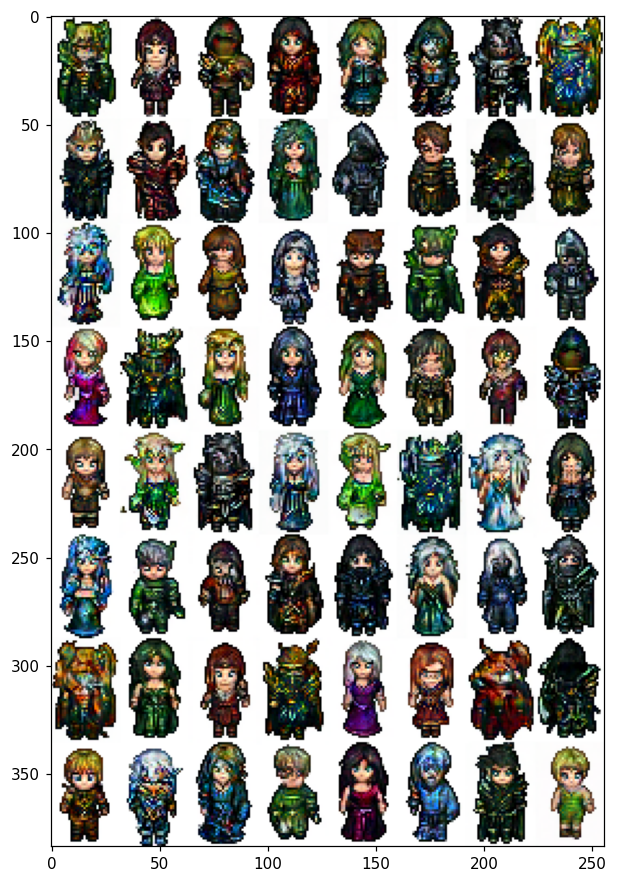



Round 1500:
D: 1.590064
G: 0.3994568
PL: 0.6792729965940094
Steps/Second: 0.79
Steps/Hour: 2835
1k Steps: 21:9
Til Completion: 70h0m



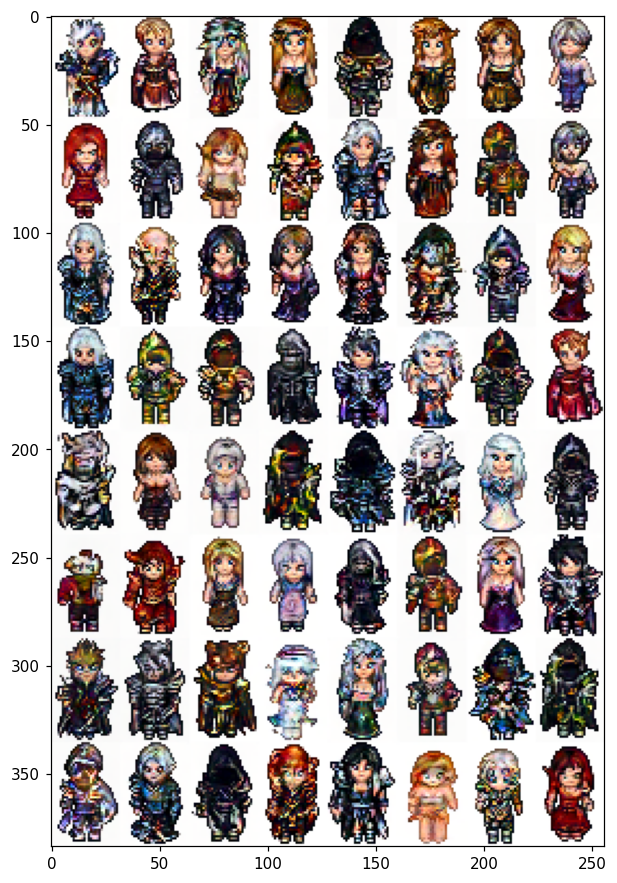



Round 1600:
D: 1.6738955
G: 0.39866257
PL: 0.7676381640412904
Steps/Second: 0.78
Steps/Hour: 2823
1k Steps: 21:15
Til Completion: 70h16m



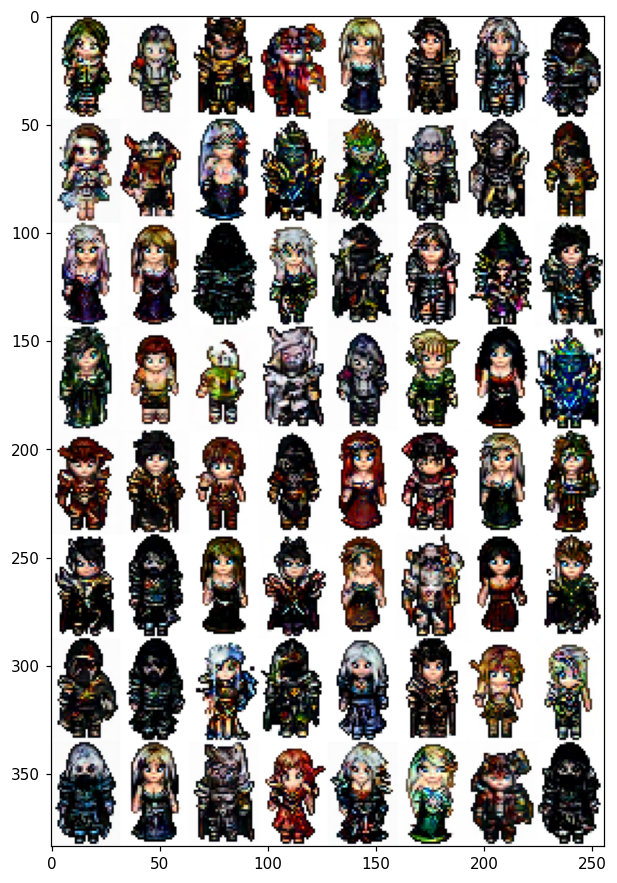



Round 1700:
D: 1.6765395
G: 0.58334094
PL: 0.732479611489713
Steps/Second: 0.79
Steps/Hour: 2842
1k Steps: 21:6
Til Completion: 69h46m



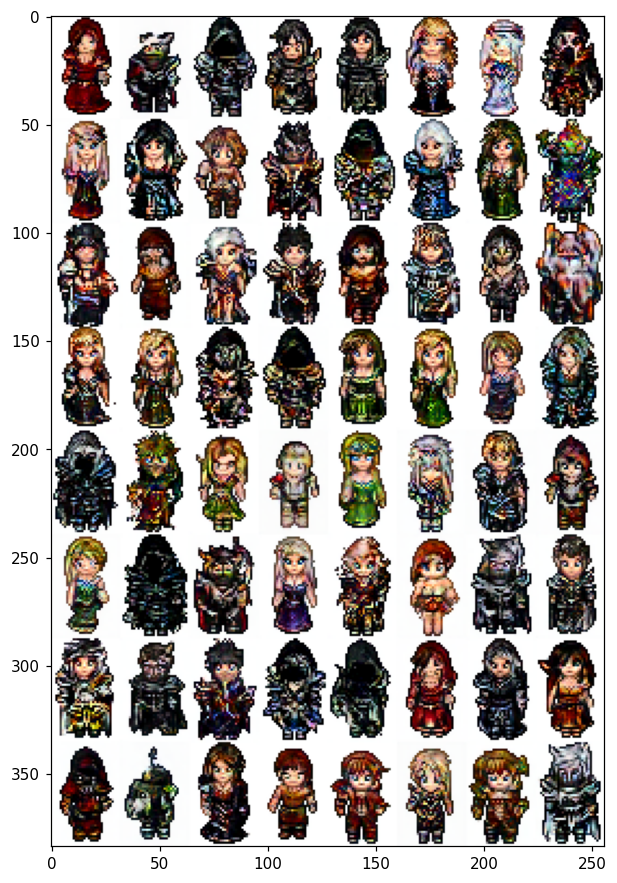



Round 1800:
D: 1.6208835
G: 0.54104817
PL: 0.676407891399846
Steps/Second: 0.79
Steps/Hour: 2832
1k Steps: 21:11
Til Completion: 69h59m



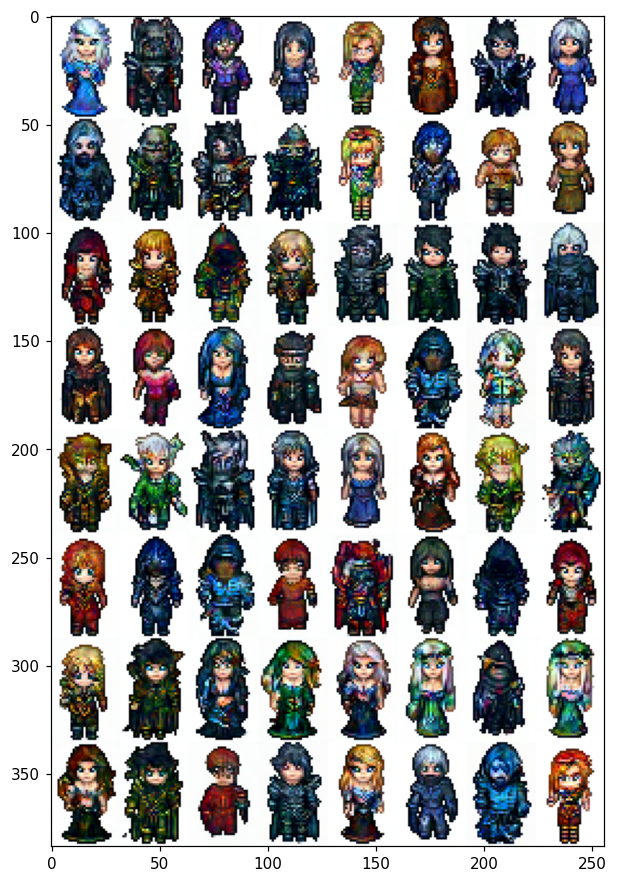



Round 1900:
D: 1.5508212
G: 0.3888623
PL: 0.6815842678931106
Steps/Second: 0.79
Steps/Hour: 2829
1k Steps: 21:12
Til Completion: 70h2m



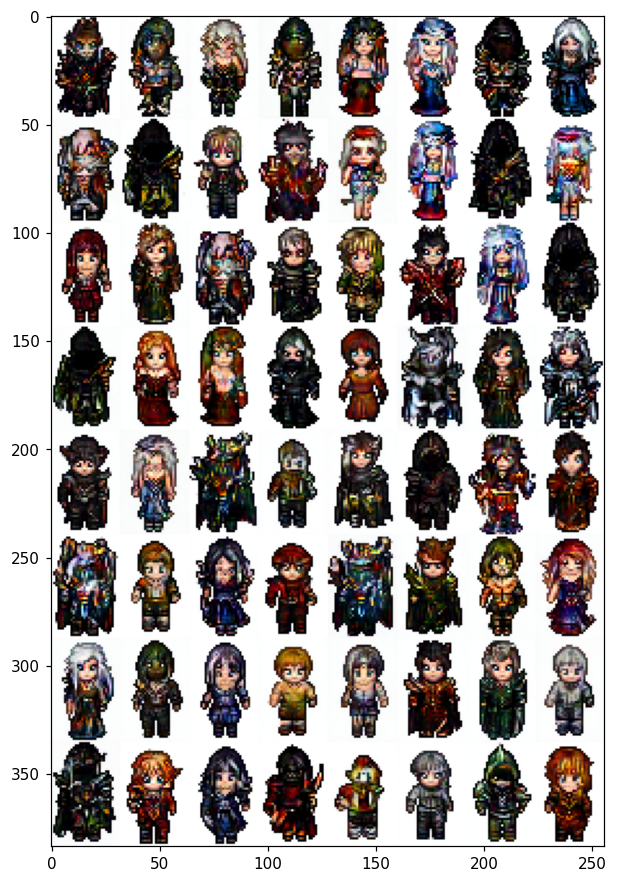



Round 2000:
D: 1.6074018
G: 0.5536375
PL: 0.7512523214734531
Steps/Second: 0.79
Steps/Hour: 2832
1k Steps: 21:11
Til Completion: 69h54m



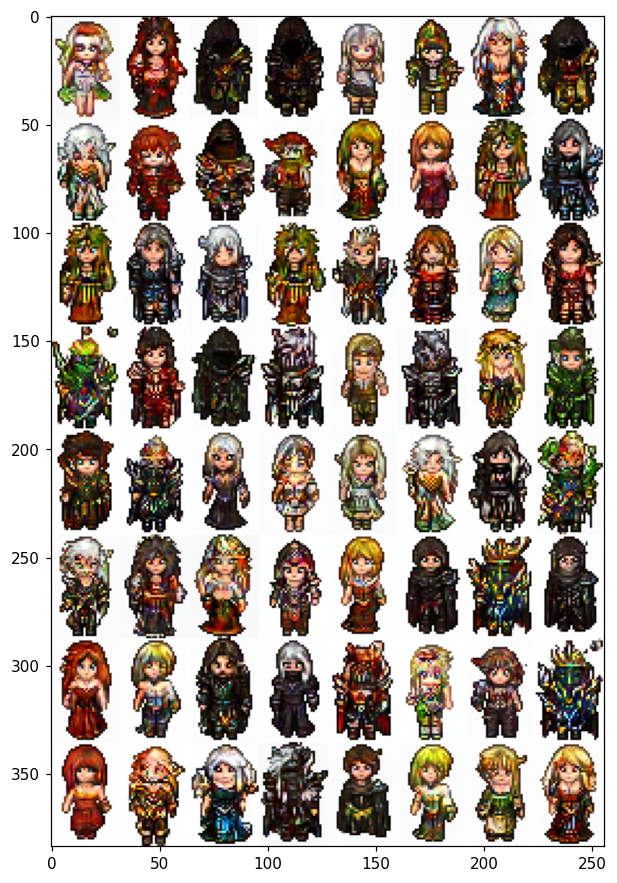



Round 2100:
D: 1.7393386
G: 0.6296462
PL: 0.7186741248679891
Steps/Second: 0.79
Steps/Hour: 2830
1k Steps: 21:12
Til Completion: 69h56m



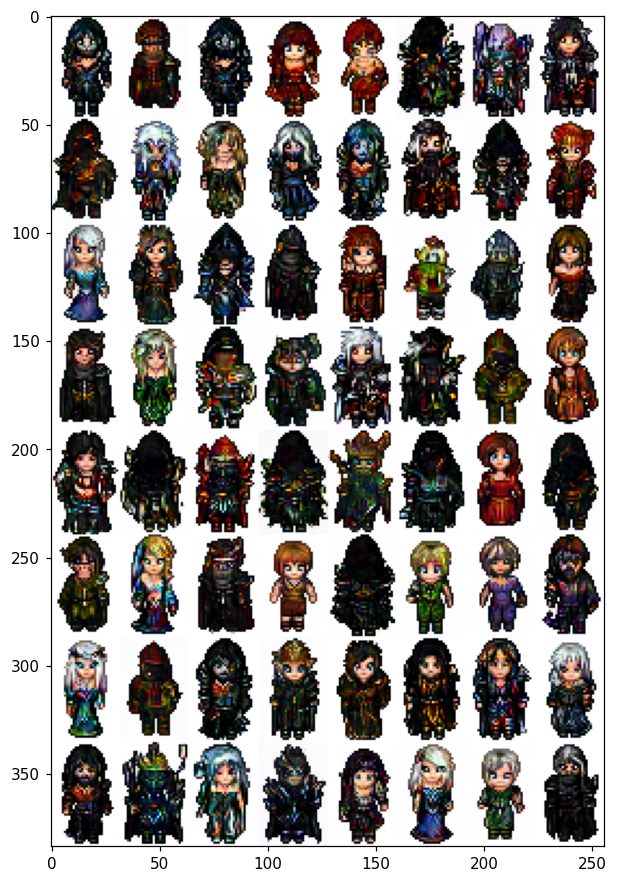



Round 2200:
D: 1.6798543
G: 0.4582344
PL: 0.7142087965088456
Steps/Second: 0.79
Steps/Hour: 2835
1k Steps: 21:9
Til Completion: 69h45m



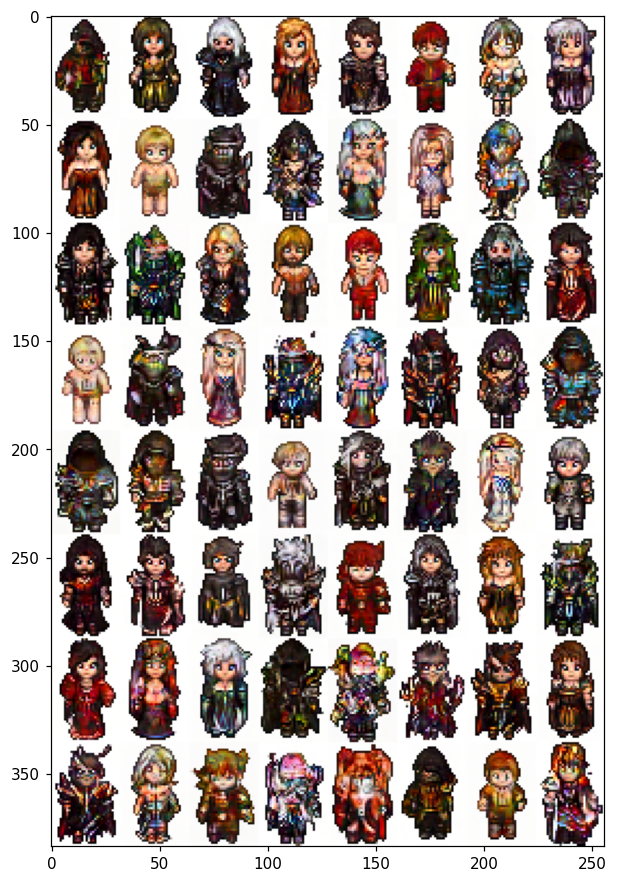



Round 2300:
D: 1.6443084
G: 0.2293351
PL: 0.6478731122646616
Steps/Second: 0.79
Steps/Hour: 2829
1k Steps: 21:12
Til Completion: 69h52m



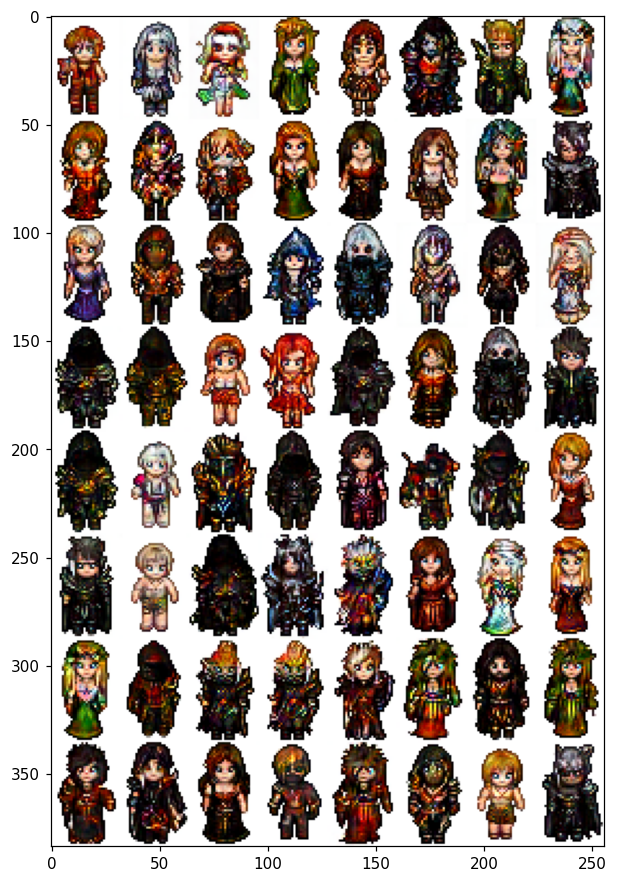



Round 2400:
D: 1.5640349
G: 0.26559582
PL: 0.770950607170907
Steps/Second: 0.79
Steps/Hour: 2831
1k Steps: 21:11
Til Completion: 69h48m



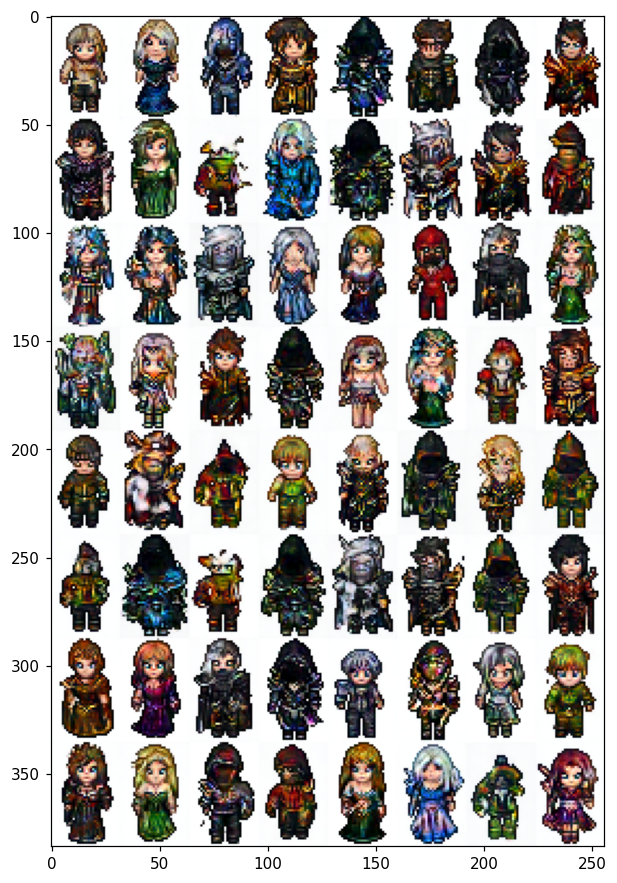



Round 2500:
D: 1.63848
G: 0.56979823
PL: 0.7303435402365406
Steps/Second: 0.79
Steps/Hour: 2831
1k Steps: 21:11
Til Completion: 69h45m



Round 2600:
D: 1.4746748
G: 0.62539047
PL: 0.6823832598054518
Steps/Second: 0.79
Steps/Hour: 2849
1k Steps: 21:3
Til Completion: 69h17m



Round 2700:
D: 1.5980628
G: 0.51599085
PL: 0.6442718562325386
Steps/Second: 0.79
Steps/Hour: 2849
1k Steps: 21:3
Til Completion: 69h15m



Round 2800:
D: 1.5363097
G: 0.55436385
PL: 0.7164671867881769
Steps/Second: 0.79
Steps/Hour: 2842
1k Steps: 21:6
Til Completion: 69h22m



Round 2900:
D: 1.5759208
G: 0.40429243
PL: 0.680481841780652
Steps/Second: 0.79
Steps/Hour: 2847
1k Steps: 21:4
Til Completion: 69h13m



Round 3000:
D: 1.6113565
G: 0.2803289
PL: 0.653449481374208
Steps/Second: 0.79
Steps/Hour: 2848
1k Steps: 21:3
Til Completion: 69h9m



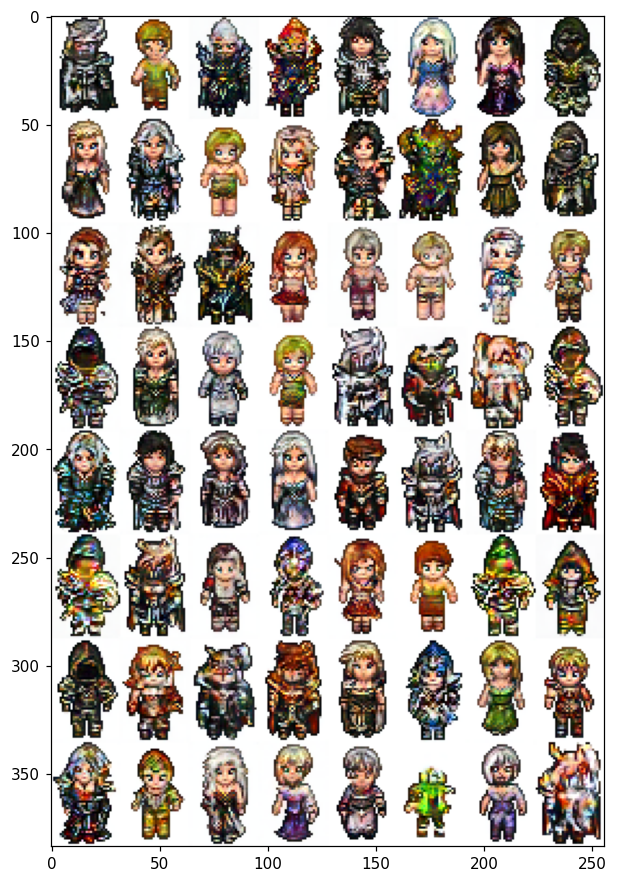



Round 3100:
D: 1.6006343
G: 0.5359398
PL: 0.6860445000885103
Steps/Second: 0.78
Steps/Hour: 2824
1k Steps: 21:14
Til Completion: 69h44m



Round 3200:
D: 1.5612378
G: 0.49617523
PL: 0.765844875462784
Steps/Second: 0.79
Steps/Hour: 2843
1k Steps: 21:6
Til Completion: 69h12m



Round 3300:
D: 1.5488552
G: 0.42576516
PL: 0.6787038875871347
Steps/Second: 0.79
Steps/Hour: 2848
1k Steps: 21:4
Til Completion: 69h4m



Round 3400:
D: 1.8126516
G: 0.8207904
PL: 0.7014718920847243
Steps/Second: 0.79
Steps/Hour: 2849
1k Steps: 21:3
Til Completion: 68h59m



Round 3500:
D: 1.5699975
G: 0.6932102
PL: 0.63781781481235
Steps/Second: 0.79
Steps/Hour: 2847
1k Steps: 21:4
Til Completion: 69h1m



Round 3600:
D: 1.5835679
G: 0.7708966
PL: 0.7148998600939424
Steps/Second: 0.79
Steps/Hour: 2832
1k Steps: 21:11
Til Completion: 69h21m



Round 3700:
D: 1.5840249
G: 0.7937245
PL: 0.7044730434287103
Steps/Second: 0.79
Steps/Hour: 2848
1k Steps: 21:4
Til Completion: 68h56m



Round 3800:
D: 1.6644524
G: 0.525

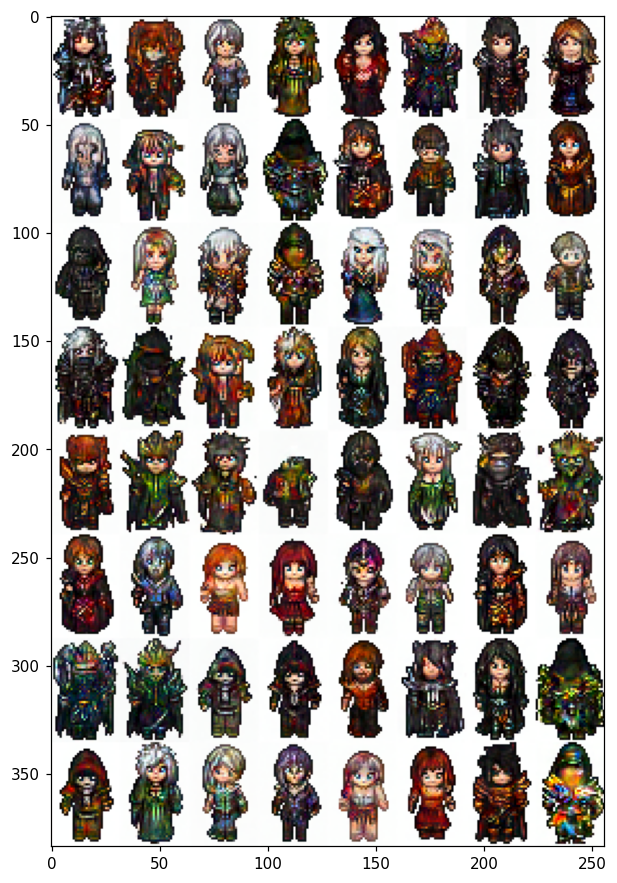



Round 4100:
D: 1.6261599
G: 0.25237632
PL: 0.6695416959024832
Steps/Second: 0.78
Steps/Hour: 2824
1k Steps: 21:14
Til Completion: 69h21m



Round 4200:
D: 1.6095344
G: 0.15974024
PL: 0.6672696188377167
Steps/Second: 0.79
Steps/Hour: 2846
1k Steps: 21:4
Til Completion: 68h47m



Round 4300:
D: 1.5744565
G: 0.37419188
PL: 0.6642497063524347
Steps/Second: 0.79
Steps/Hour: 2845
1k Steps: 21:5
Til Completion: 68h47m



Round 4400:
D: 1.6573522
G: 0.41225058
PL: 0.7613275632764417
Steps/Second: 0.79
Steps/Hour: 2840
1k Steps: 21:7
Til Completion: 68h51m



Round 4500:
D: 1.5936127
G: 0.58789206
PL: 0.6879103336643688
Steps/Second: 0.79
Steps/Hour: 2841
1k Steps: 21:7
Til Completion: 68h49m



In [ ]:
from PIL import Image
from math import floor, log2
import numpy as np
import time
from functools import partial
from random import random
import os
import matplotlib.pyplot as plt

from tensorflow.keras.layers import *
from tensorflow.keras.models import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.initializers import *
import tensorflow as tf
import tensorflow.keras.backend as K

def nImage(n):
    return np.random.uniform(0.0, 1.0, size = [n, im_size[0], im_size[1], 1]).astype('float32')

def noise(n):
    return np.random.normal(0.0, 1.0, size = [n, latent_size]).astype('float32')

def noiseList(n):
    return [noise(n)] * n_layers

def mixedList(n):
    tt = int(random() * n_layers)
    p1 = [noise(n)] * tt
    p2 = [noise(n)] * (n_layers - tt)
    return p1 + [] + p2

#Loss functions
def gradient_penalty(samples, output, weight):
    gradients = K.gradients(output, samples)[0]
    gradients_sqr = K.square(gradients)
    gradient_penalty = K.sum(gradients_sqr,
                              axis=np.arange(1, len(gradients_sqr.shape)))

    # (weight / 2) * ||grad||^2
    # Penalize the gradient norm
    return K.mean(gradient_penalty) * weight

def hinge_d(y_true, y_pred):
    return K.mean(K.relu(1.0 + (y_true * y_pred)))

def w_loss(y_true, y_pred):
    return K.mean(y_true * y_pred)


#Lambdas
def crop_to_fit(x):

    height = x[1].shape[1]
    width = x[1].shape[2]

    return x[0][:, :height, :width, :]

def upsample(x):
    return K.resize_images(x,2,2,"channels_last",interpolation='bilinear')

def upsample_to_size(x):
    x = K.resize_images(x, im_size[0] // x.shape[1], im_size[1] // x.shape[2], "channels_last",interpolation='bilinear')
    return x


#Blocks
def g_block(inp, istyle, inoise, fil, u = True):

    if u:
        #Custom upsampling because of clone_model issue
        out = Lambda(upsample, output_shape=[None, inp.shape[2] * 2, inp.shape[2] * 2, None])(inp)
    else:
        out = Activation('linear')(inp)

    rgb_style = Dense(fil, kernel_initializer = VarianceScaling(200/out.shape[2]))(istyle)
    style = Dense(inp.shape[-1], kernel_initializer = 'he_uniform')(istyle)
    delta = Lambda(crop_to_fit)([inoise, out])
    d = Dense(fil, kernel_initializer = 'zeros')(delta)

    out = Conv2DMod(filters = fil, kernel_size = 3, padding = 'same', kernel_initializer = 'he_uniform')([out, style])
    out = add([out, d])
    out = LeakyReLU(0.2)(out)

    style = Dense(fil, kernel_initializer = 'he_uniform')(istyle)
    d = Dense(fil, kernel_initializer = 'zeros')(delta)

    out = Conv2DMod(filters = fil, kernel_size = 3, padding = 'same', kernel_initializer = 'he_uniform')([out, style])
    out = add([out, d])
    out = LeakyReLU(0.2)(out)

    return out, to_rgb(out, rgb_style)

def d_block(inp, fil, p = True):

    res = Conv2D(fil, 1, kernel_initializer = 'he_uniform')(inp)

    out = Conv2D(filters = fil, kernel_size = 3, padding = 'same', kernel_initializer = 'he_uniform')(inp)
    out = LeakyReLU(0.2)(out)
    out = Conv2D(filters = fil, kernel_size = 3, padding = 'same', kernel_initializer = 'he_uniform')(out)
    out = LeakyReLU(0.2)(out)

    out = add([res, out])

    if p:
        out = AveragePooling2D()(out)

    return out

def to_rgb(inp, style):
    size = inp.shape[2]
    x = Conv2DMod(3, 1, kernel_initializer = VarianceScaling(200/size), demod = False)([inp, style])
    return Lambda(upsample_to_size, output_shape=[None, im_size[0], im_size[1], None])(x)





class GAN(object):

    def __init__(self, steps = 1, lr = 0.0001, decay = 0.00001):

        #Models
        self.D = None
        self.S = None
        self.G = None

        self.GE = None
        self.SE = None

        self.DM = None
        self.AM = None

        #Config
        self.LR = lr
        self.steps = steps
        self.beta = 0.999

        #Init Models
        self.discriminator()
        self.generator()

        self.GMO = Adam(lr = self.LR, beta_1 = 0, beta_2 = 0.999)
        self.DMO = Adam(lr = self.LR, beta_1 = 0, beta_2 = 0.999)

        self.GE = clone_model(self.G)
        self.GE.set_weights(self.G.get_weights())

        self.SE = clone_model(self.S)
        self.SE.set_weights(self.S.get_weights())

    def discriminator(self):

        if self.D:
            return self.D

        inp = Input(shape = [im_size[0], im_size[1], 3])


        x = d_block(inp, 128)   #128 1*cha

        x = d_block(x, 128)   #128 1*cha

        #x = d_block(x, 128)   #64 2*cha

        #x = d_block(x, 128)   #64 2*cha

        #x = d_block(x, 256)
        '''
        x = d_block(x, 4 * cha)   #32

        x = d_block(x, 6 * cha)  #16

        x = d_block(x, 8 * cha)  #8
        '''
        '''
        x = d_block(x, 16 * cha, p=False)  #4

        x = d_block(x, 32 * cha, p = False)  #4
        '''
        x = Flatten()(x)

        x = Dense(1, kernel_initializer = 'he_uniform')(x)

        self.D = Model(inputs = inp, outputs = x)

        return self.D

    def generator(self):

        if self.G:
            return self.G

        # === Style Mapping ===

        self.S = Sequential()

        self.S.add(Dense(100, input_shape = [latent_size]))
        self.S.add(LeakyReLU(0.2))
        self.S.add(Dense(100))
        self.S.add(LeakyReLU(0.2))
        '''
        self.S.add(Dense(100))
        self.S.add(LeakyReLU(0.2))
        
        self.S.add(Dense(100))
        self.S.add(LeakyReLU(0.2))
        '''

        # === Generator ===

        #Inputs
        inp_style = []

        for i in range(n_layers):
            inp_style.append(Input([100]))

        inp_noise = Input([im_size[0], im_size[1], 1])

        #Latent
        x = Lambda(lambda x: x[:, :1] * 0 + 1)(inp_style[0])

        outs = []

        #Actual Model
        x = Dense(24*16*4*cha, activation = 'relu', kernel_initializer = 'random_normal')(x) #24x16
        x = Reshape([24, 16, 4*cha])(x)

        x, r = g_block(x, inp_style[0], inp_noise, 128, u = False)  #4 32 * cha
        outs.append(r)

        x, r = g_block(x, inp_style[1], inp_noise, 128)  #8 16 * cha
        outs.append(r)

        x, r = g_block(x, inp_style[1], inp_noise, 128, u=False)  #8 16 * cha
        outs.append(r)

        '''
        x, r = g_block(x, inp_style[2], inp_noise, 128)  #8 16 * cha
        outs.append(r)
        
        
        x, r = g_block(x, inp_style[3], inp_noise, 128)  #16
        outs.append(r)
        '''
        '''
        x, r = g_block(x, inp_style[3], inp_noise, 6 * cha)  #32
        outs.append(r)
        '''
        '''
        x, r = g_block(x, inp_style[4], inp_noise, 4 * cha)   #64
        outs.append(r)

        x, r = g_block(x, inp_style[5], inp_noise, 2 * cha)   #128
        outs.append(r)

        x, r = g_block(x, inp_style[6], inp_noise, 1 * cha)   #256
        outs.append(r)
        '''

        x = add(outs)

        #x = Lambda(lambda y: y/2 + 0.5)(x) #Use values centered around 0, but normalize to [0, 1], providing better initialization

        self.G = Model(inputs = inp_style + [inp_noise], outputs = x)

        return self.G

    def GenModel(self):

        #Generator Model for Evaluation

        inp_style = []
        style = []

        for i in range(n_layers):
            inp_style.append(Input([latent_size]))
            style.append(self.S(inp_style[-1]))

        inp_noise = Input([im_size[0], im_size[1], 1])

        gf = self.G(style + [inp_noise])

        self.GM = Model(inputs = inp_style + [inp_noise], outputs = gf)

        return self.GM

    def GenModelA(self):

        #Parameter Averaged Generator Model

        inp_style = []
        style = []

        for i in range(n_layers):
            inp_style.append(Input([latent_size]))
            style.append(self.SE(inp_style[-1]))

        inp_noise = Input([im_size[0], im_size[1], 1])

        gf = self.GE(style + [inp_noise])

        self.GMA = Model(inputs = inp_style + [inp_noise], outputs = gf)

        return self.GMA

    def EMA(self):

        #Parameter Averaging

        for i in range(len(self.G.layers)):
            up_weight = self.G.layers[i].get_weights()
            old_weight = self.GE.layers[i].get_weights()
            new_weight = []
            for j in range(len(up_weight)):
                new_weight.append(old_weight[j] * self.beta + (1-self.beta) * up_weight[j])
            self.GE.layers[i].set_weights(new_weight)

        for i in range(len(self.S.layers)):
            up_weight = self.S.layers[i].get_weights()
            old_weight = self.SE.layers[i].get_weights()
            new_weight = []
            for j in range(len(up_weight)):
                new_weight.append(old_weight[j] * self.beta + (1-self.beta) * up_weight[j])
            self.SE.layers[i].set_weights(new_weight)

    def MAinit(self):
        #Reset Parameter Averaging
        self.GE.set_weights(self.G.get_weights())
        self.SE.set_weights(self.S.get_weights())


class StyleGAN(object):

    def __init__(self, dataset_path, steps = 1, lr = 0.0001, decay = 0.00001, silent = True):

        #Init GAN and Eval Models
        self.GAN = GAN(steps = steps, lr = lr, decay = decay)
        self.GAN.GenModel()
        self.GAN.GenModelA()

        self.GAN.G.summary()

        #Data generator (my own code, not from TF 2.0)
        self.im = dataGenerator(dataset_path, flip = True)

        #Set up variables
        self.lastblip = time.clock()

        self.silent = silent

        self.ones = np.ones((BATCH_SIZE, 1), dtype=np.float32)
        self.zeros = np.zeros((BATCH_SIZE, 1), dtype=np.float32)
        self.nones = -self.ones

        self.pl_mean = 0
        self.av = np.zeros([44])

    def train(self):

        #Train Alternating
        if random() < mixed_prob:
            style = mixedList(BATCH_SIZE)
        else:
            style = noiseList(BATCH_SIZE)

        #Apply penalties every 16 steps
        apply_gradient_penalty = self.GAN.steps % 2 == 0 or self.GAN.steps < 10000
        apply_path_penalty = self.GAN.steps % 16 == 0

        a, b, c, d = self.train_step(self.im.get_batch(BATCH_SIZE), style, nImage(BATCH_SIZE), apply_gradient_penalty, apply_path_penalty)

        #Adjust path length penalty mean
        #d = pl_mean when no penalty is applied
        if self.pl_mean == 0:
            self.pl_mean = np.mean(d)
        self.pl_mean = 0.99*self.pl_mean + 0.01*np.mean(d)

        if self.GAN.steps % 10 == 0 and self.GAN.steps > 20000:
            self.GAN.EMA()

        if self.GAN.steps <= 25000 and self.GAN.steps % 1000 == 2:
            self.GAN.MAinit()

        if np.isnan(a):
            print("NaN Value Error.")
            exit()


        #Print info
        if self.GAN.steps % 100 == 0 and not self.silent:
            print("\n\nRound " + str(self.GAN.steps) + ":")
            print("D:", np.array(a))
            print("G:", np.array(b))
            print("PL:", self.pl_mean)

            s = round((time.clock() - self.lastblip), 4)
            self.lastblip = time.clock()

            steps_per_second = 100 / s
            steps_per_minute = steps_per_second * 60
            steps_per_hour = steps_per_minute * 60
            print("Steps/Second: " + str(round(steps_per_second, 2)))
            print("Steps/Hour: " + str(round(steps_per_hour)))

            min1k = floor(1000/steps_per_minute)
            sec1k = floor(1000/steps_per_second) % 60
            print("1k Steps: " + str(min1k) + ":" + str(sec1k))
            steps_left = 200000 - self.GAN.steps + 1e-7
            hours_left = steps_left // steps_per_hour
            minutes_left = (steps_left // steps_per_minute) % 60

            print("Til Completion: " + str(int(hours_left)) + "h" + str(int(minutes_left)) + "m")
            print()

            #Save Model
            if self.GAN.steps % 500 == 0:
                self.save(self.GAN.steps)
            if self.GAN.steps % 1000 == 0 or (self.GAN.steps % 100 == 0 and self.GAN.steps < 2500):
                self.evaluate(self.GAN.steps)

        self.GAN.steps = self.GAN.steps + 1

    @tf.function
    def train_step(self, images, style, noise, perform_gp = True, perform_pl = False):

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            #Get style information
            w_space = []
            pl_lengths = self.pl_mean
            for i in range(len(style)):
                w_space.append(self.GAN.S(style[i]))

            #Generate images
            generated_images = self.GAN.G(w_space + [noise])

            #Discriminate
            real_output = self.GAN.D(images, training=True)
            fake_output = self.GAN.D(generated_images, training=True)

            #Hinge loss function
            gen_loss = K.mean(fake_output)
            divergence = K.mean(K.relu(1 + real_output) + K.relu(1 - fake_output))
            disc_loss = divergence

            if perform_gp:
                #R1 gradient penalty
                disc_loss += gradient_penalty(images, real_output, 10)

            if perform_pl:
                #Slightly adjust W space
                w_space_2 = []
                for i in range(len(style)):
                    std = 0.1 / (K.std(w_space[i], axis = 0, keepdims = True) + 1e-8)
                    w_space_2.append(w_space[i] + K.random_normal(tf.shape(w_space[i])) / (std + 1e-8))

                #Generate from slightly adjusted W space
                pl_images = self.GAN.G(w_space_2 + [noise])

                #Get distance after adjustment (path length)
                delta_g = K.mean(K.square(pl_images - generated_images), axis = [1, 2, 3])
                pl_lengths = delta_g

                if self.pl_mean > 0:
                    gen_loss += K.mean(K.square(pl_lengths - self.pl_mean))

        #Get gradients for respective areas
        gradients_of_generator = gen_tape.gradient(gen_loss, self.GAN.GM.trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, self.GAN.D.trainable_variables)

        #Apply gradients
        self.GAN.GMO.apply_gradients(zip(gradients_of_generator, self.GAN.GM.trainable_variables))
        self.GAN.DMO.apply_gradients(zip(gradients_of_discriminator, self.GAN.D.trainable_variables))

        return disc_loss, gen_loss, divergence, pl_lengths

    def evaluate(self, num = 0, trunc = 1.0):

        n1 = noiseList(64)
        n2 = seed
        trunc = np.ones([64, 1]) * trunc

        generated_images = self.GAN.GM.predict(n1 + [n2], batch_size = BATCH_SIZE)

        r = []

        for i in range(0, 64, 8):
            r.append(np.concatenate(generated_images[i:i+8], axis = 1))

        c1 = np.concatenate(r, axis = 0)
        to_show = np.clip(((c1 + 1.0)*127.5),0, 255).astype(np.uint8)
        c1 = np.clip(c1, -1.0, 1.0)
        x = Image.fromarray(np.uint8(c1*255))
        plt.figure(figsize=(10,10), dpi=110)
        plt.imshow(to_show)
        path = drive + '/Images10_5/' + str(num) + ".png"
        
        plt.savefig(path, dpi=110)
        plt.show()
        # Moving Average
        '''
        generated_images = self.GAN.GMA.predict(n1 + [n2, trunc], batch_size = BATCH_SIZE)
        #generated_images = self.generateTruncated(n1, trunc = trunc)

        r = []

        for i in range(0, 64, 8):
            r.append(np.concatenate(generated_images[i:i+8], axis = 1))

        c1 = np.concatenate(r, axis = 0)
        c1 = np.clip(c1, 0.0, 1.0)

        x = Image.fromarray(np.uint8(c1*255))

        x.save(drive + 'Images/' + str(num) + "-ema.png")

        #Mixing Regularities
        nn = noise(8)
        n1 = np.tile(nn, (8, 1))
        n2 = np.repeat(nn, 8, axis = 0)
        tt = int(n_layers / 2)

        p1 = [n1] * tt
        p2 = [n2] * (n_layers - tt)

        latent = p1 + [] + p2

        generated_images = self.GAN.GMA.predict(latent + [nImage(64), trunc], batch_size = BATCH_SIZE)
        #generated_images = self.generateTruncated(latent, trunc = trunc)

        r = []

        for i in range(0, 64, 8):
            r.append(np.concatenate(generated_images[i:i+8], axis = 0))

        c1 = np.concatenate(r, axis = 1)
        c1 = np.clip(c1, 0.0, 1.0)

        x = Image.fromarray(np.uint8(c1*255))

        x.save(drive + 'Images/' + str(num) + "-mr.png")
        '''

    def generateTruncated(self, style, noi = np.zeros([44]), trunc = 0.5, outImage = False, num = 0):

        #Get W's center of mass
        if self.av.shape[0] == 44: #44 is an arbitrary value
            print("Approximating W center of mass")
            self.av = np.mean(self.GAN.S.predict(noise(2000), batch_size = 64), axis = 0)
            self.av = np.expand_dims(self.av, axis = 0)

        if noi.shape[0] == 44:
            noi = nImage(64)

        w_space = []
        pl_lengths = self.pl_mean
        for i in range(len(style)):
            tempStyle = self.GAN.S.predict(style[i])
            tempStyle = trunc * (tempStyle - self.av) + self.av
            w_space.append(tempStyle)

        generated_images = self.GAN.GE.predict(w_space + [noi], batch_size = BATCH_SIZE)

        if outImage:
            r = []

            for i in range(0, 64, 8):
                r.append(np.concatenate(generated_images[i:i+8], axis = 0))

            c1 = np.concatenate(r, axis = 1)
            c1 = np.clip(c1, 0.0, 1.0)

            x = Image.fromarray(np.uint8(c1*255))

            x.save(drive + 'Images10_2/' + str(num) + ".png")

        return generated_images

    def saveModel(self, model, name, num):
        json = model.to_json()
        with open(drive + '/Models10_5/' + name + ".json", "w") as json_file:
            json_file.write(json)

        model.save_weights(drive + "/Models10_5/" + name + "_" + str(num) + ".h5")

    def loadModel(self, name, num):
        file = open(drive + "/Models10_4/" + name + ".json", 'r')
        json = file.read()
        file.close()

        mod = model_from_json(json, custom_objects = {'Conv2DMod': Conv2DMod})
        mod.load_weights(drive + "/Models10_4/" + name + "_"+str(num) + ".h5")

        return mod

    def save(self, num): #Save JSON and Weights into /Models/
        self.saveModel(self.GAN.S, "sty", num)
        self.saveModel(self.GAN.G, "gen", num)
        self.saveModel(self.GAN.D, "dis", num)

        self.saveModel(self.GAN.GE, "genMA", num)
        self.saveModel(self.GAN.SE, "styMA", num)


    def load(self, num): #Load JSON and Weights from /Models/

        #Load Models
        self.GAN.D = self.loadModel("dis", num)
        self.GAN.S = self.loadModel("sty", num)
        self.GAN.G = self.loadModel("gen", num)

        self.GAN.GE = self.loadModel("genMA", num)
        self.GAN.SE = self.loadModel("styMA", num)

        self.GAN.GenModel()
        self.GAN.GenModelA()

if __name__ == "__main__":

    im_size = (48, 32)
    seed = nImage(64)
    cha = 3
    mixed_prob = 0.9
    n_layers = 2#int(log2(im_size[1]) - 1)
    print(n_layers)
    latent_size = 100
    BATCH_SIZE = 256
    drive = '/content/drive/My Drive/StyleGAN'
    model = StyleGAN(dataset_path='/content/drive/My Drive/dataset.npy', lr = 0.00005, silent = False) #lr = 0.0001
    model.load('2500')
    while model.GAN.steps < 1000001:
        model.train()

    """
    model.load(31)

    n1 = noiseList(64)
    n2 = nImage(64)
    for i in range(50):
        print(i, end = '\r')
        model.generateTruncated(n1, noi = n2, trunc = i / 50, outImage = True, num = i)
    """


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
